## Imports and Setup

In [ ]:
#!git clone https://github.com/GFDRR/disaster-fcv-colocation-mapping.git
#%cd disaster-fcv-colocation-mapping
#!apt-get update && apt-get install -y --no-install-recommends gdal-bin
#!pip install -r requirements.txt

In [ ]:
#%cd disaster-fcv-colocation-mapping
#%ls

In [2]:
#import sys
#sys.path.insert(0, "./")

import os 
os.chdir('../')
from utils import data_download
from utils import data_utils
from utils import map_utils

import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 1000)

%load_ext autoreload
%autoreload 2

## Parameters

In [47]:
iso_code = "MMR"
adm_source = "MIMU"
adm_level = "ADM3"
acled_start_date = "2021-01-01"

## Download Datasets

In [103]:
dm = data_download.DatasetManager(
    iso_code, 
    adm_level=adm_level,
    acled_start_date=acled_start_date,
    adm_source=adm_source
)
geoplot = map_utils.GeoPlot(dm)
dm.data.sort_values("mhs_dfcv_conflict_exposure_relative", ascending=False).head(2)

INFO:root:Loading geoboundary...
INFO:root:Loading hazard layers...
INFO:root:Loading conflict data...


,ADM1,ADM1_ID,ADM2,ADM2_ID,ADM3,ADM3_ID,iso_code,worldpop,earthquake,earthquake_exposure,landslide,landslide_exposure,cyclone,cyclone_exposure,geometry,coastal_defended,coastal_defended_exposure,fluvial_defended,fluvial_defended_exposure,pluvial_defended,pluvial_defended_exposure,population_best,conflict_count,null_conflict_count,acled_conflict_exposure,dfcv_conflict_exposure,earthquake_exposure_relative,landslide_exposure_relative,cyclone_exposure_relative,coastal_defended_exposure_relative,fluvial_defended_exposure_relative,pluvial_defended_exposure_relative,acled_conflict_exposure_relative,dfcv_conflict_exposure_relative,mhs_exposure_relative,mhs_dfcv_conflict_exposure_relative,BLOC
194,Mandalay,MMR010,Pyinoolwin,MMR010D002,Mogoke,MMR010011,MMR,172943.03125,0.214556,163473.93750,3.376164,141609.328125,83.459253,172943.03125,"MULTIPOLYGON (((96.54303 23.02326, 96.54407 23...",0.0,0.0,0.001667,198.557907,0.021851,14656.786133,10835210.0,473.0,145.0,33034.176829,157050.281250,0.945247,0.818821,1.0,0.0,0.001148,0.084749,0.191012,0.908104,0.918155,0.833781,Dry zone
47,Magway,MMR009,Gangaw,MMR009D005,Saw,MMR009025,MMR,69289.78125,0.215581,69289.78125,2.875622,43609.453125,132.448155,69289.78125,"MULTIPOLYGON (((94.21669 21.6016, 94.21669 21....",0.0,0.0,0.001877,447.752350,0.026177,5909.084473,317764.0,338.0,92.0,1291.723577,57516.441406,1.000000,0.629378,1.0,0.0,0.006462,0.085281,0.018642,0.830085,0.856990,0.711375,Dry zone


# Publication-ready Maps

## Plot Regional Groupings

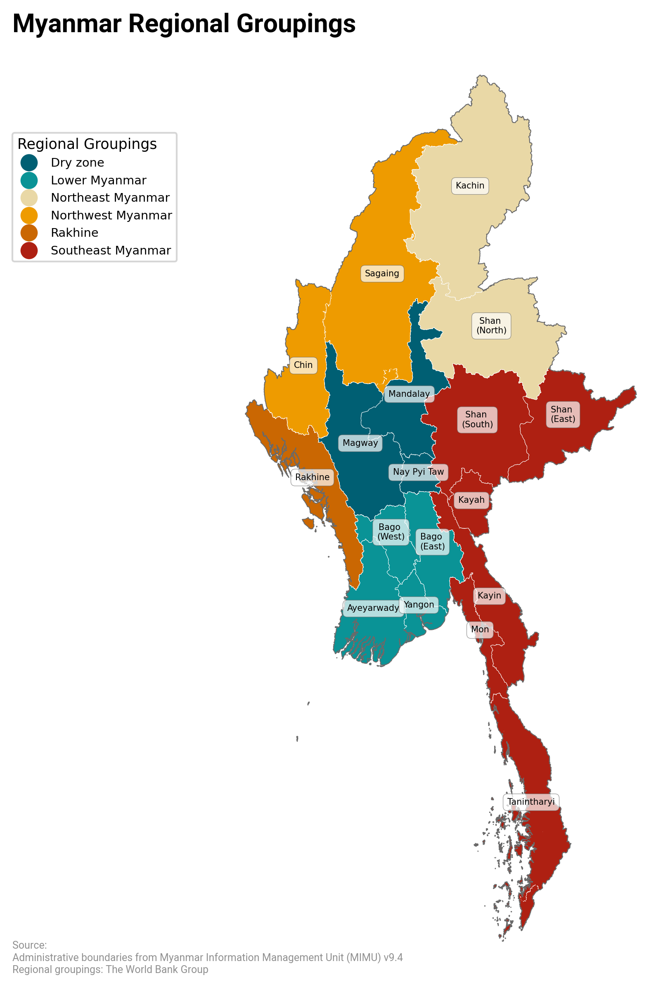

In [66]:
geoplot.plot_geoboundaries(
    adm_level="ADM1", 
    group="BLOC",
    title="Myanmar Regional Groupings",
    annotation="Regional groupings: The World Bank Group"
)

## Plot Population

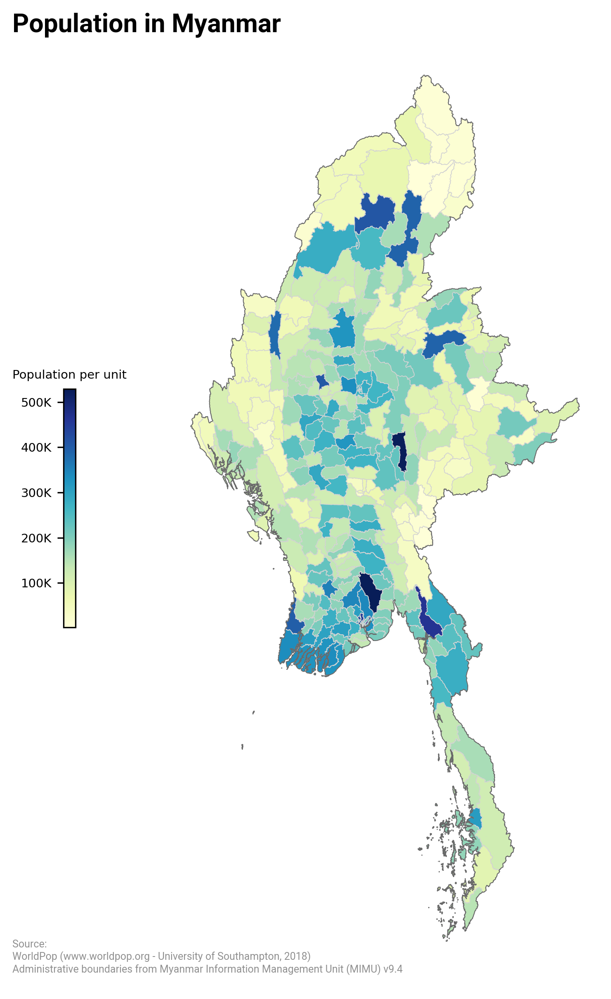

In [61]:
geoplot.plot_choropleth( 
    var="worldpop",
    update_config={"legend_type": "colorbar"}
)

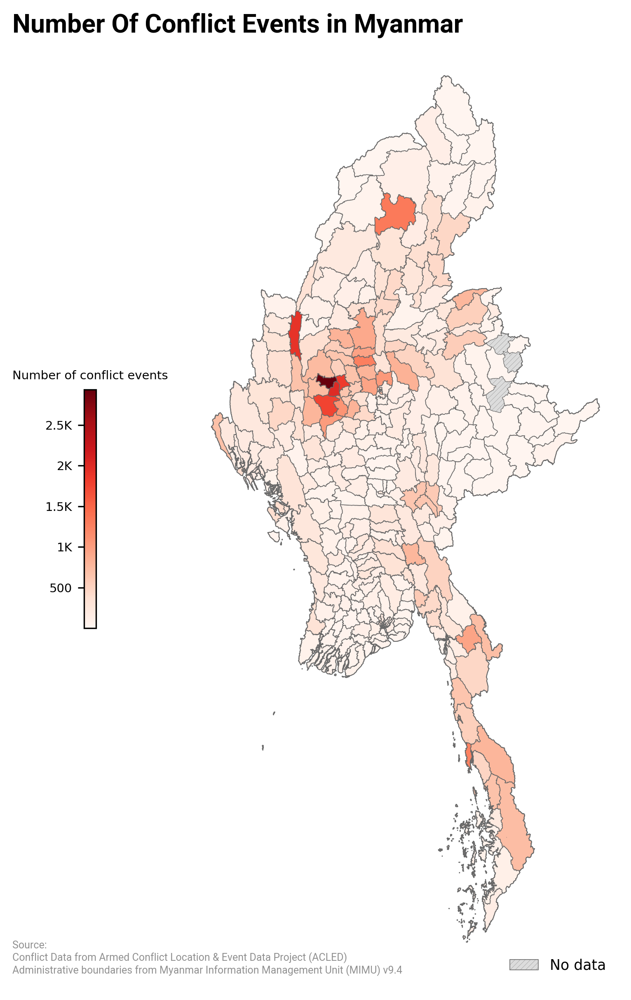

In [67]:
geoplot.plot_choropleth( 
    var="conflict_count",
    update_config={
        "legend_type": "colorbar",
        "palette_name": "Reds",
        "edgecolor": "dimgray"
    }
)

## Plot Conflict Exposure - ACLED

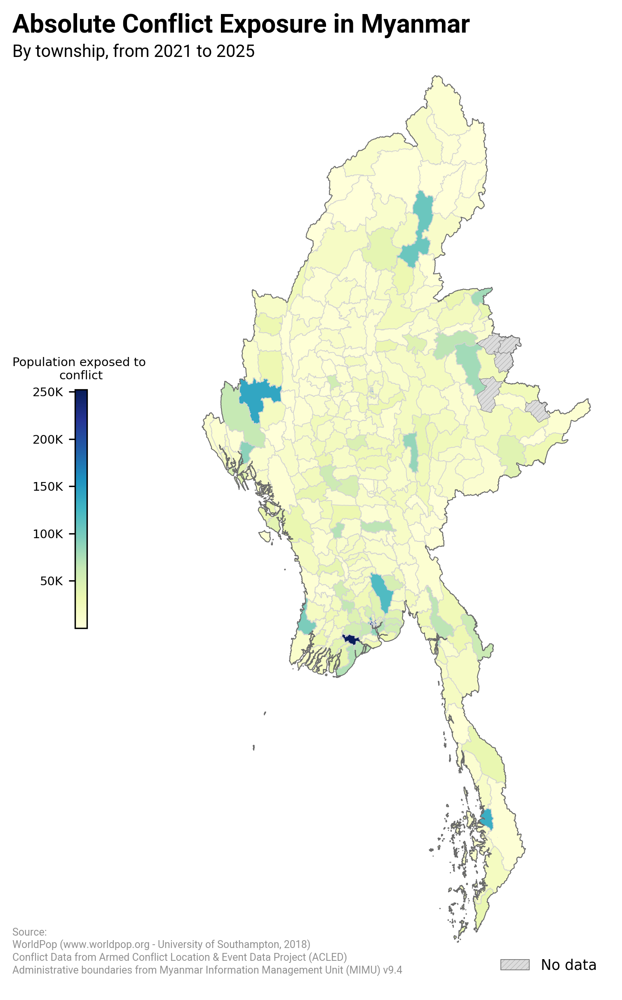

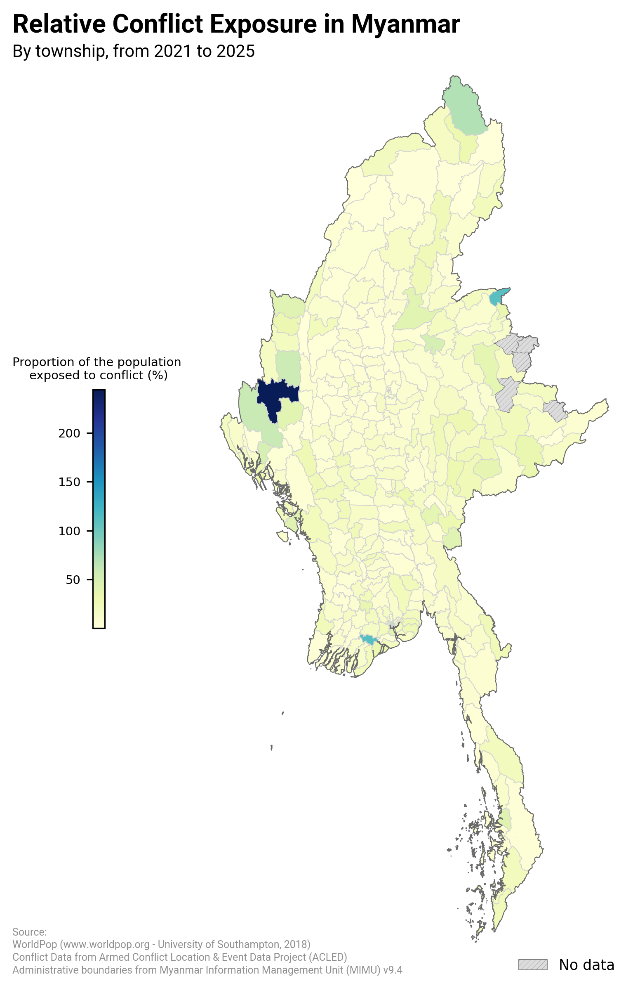

In [56]:
source = "acled"
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure",
    subtitle="By township, from 2021 to 2025",
    update_config={"legend_type": "colorbar"}
)
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure_relative",
    subtitle="By township, from 2021 to 2025",
    update_config={"legend_type": "colorbar"}
)

## Plot Conflict Exposure - World Bank

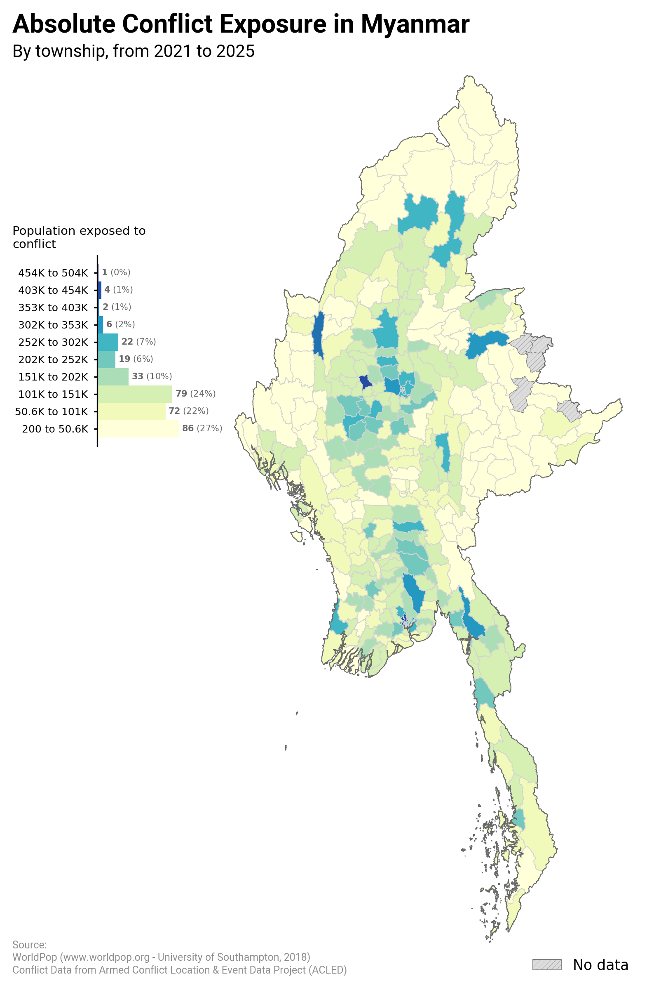

In [17]:
source = "dfcv"
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure",
    subtitle="By township, from 2021 to 2025"
)

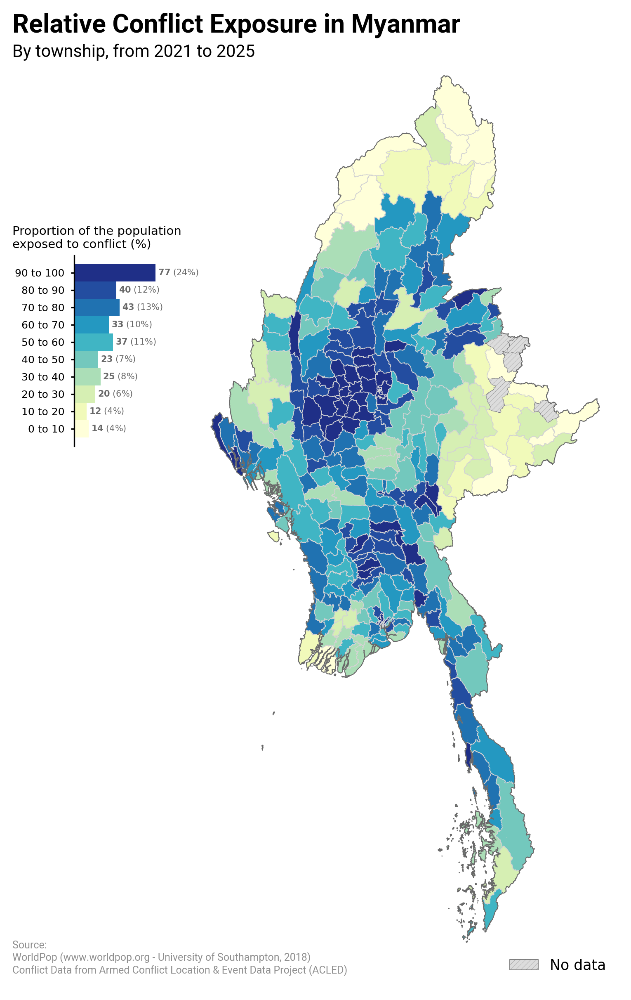

In [18]:
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure_relative",
    var_bounds=[0, 100],
    subtitle="By township, from 2021 to 2025"
)

## Zoom Choropleth to a specific region

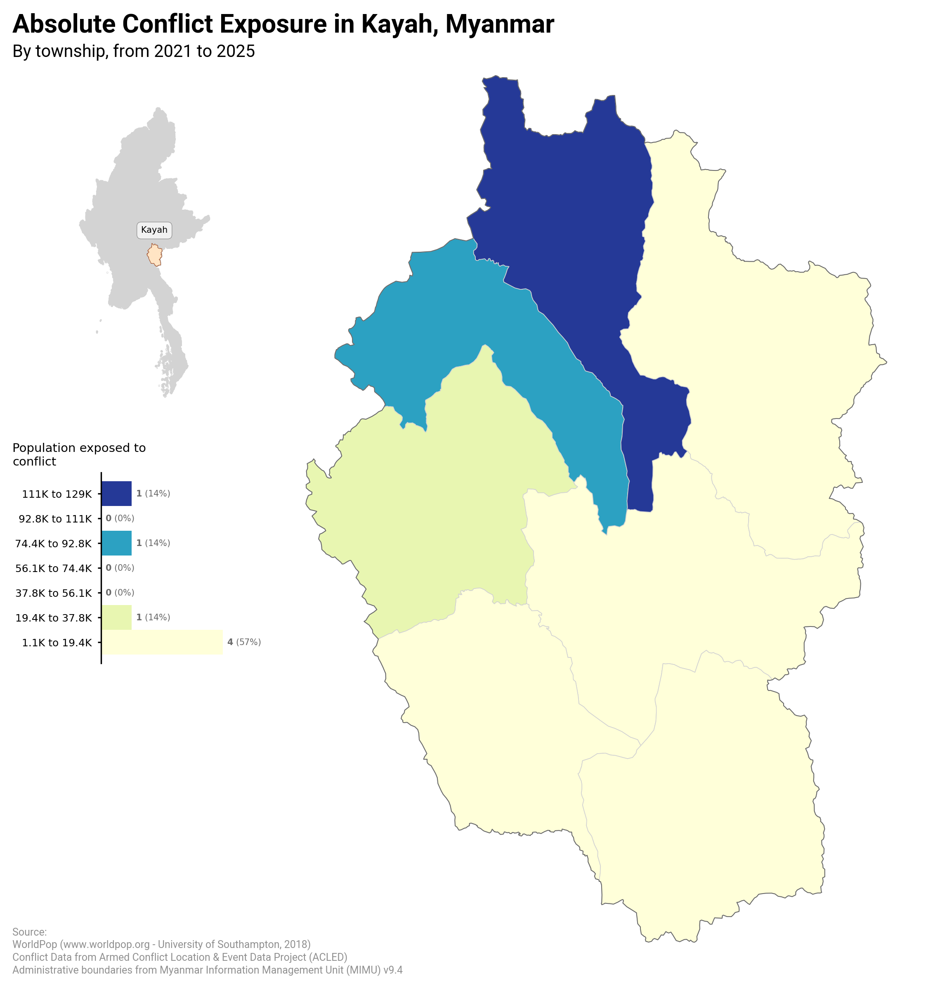

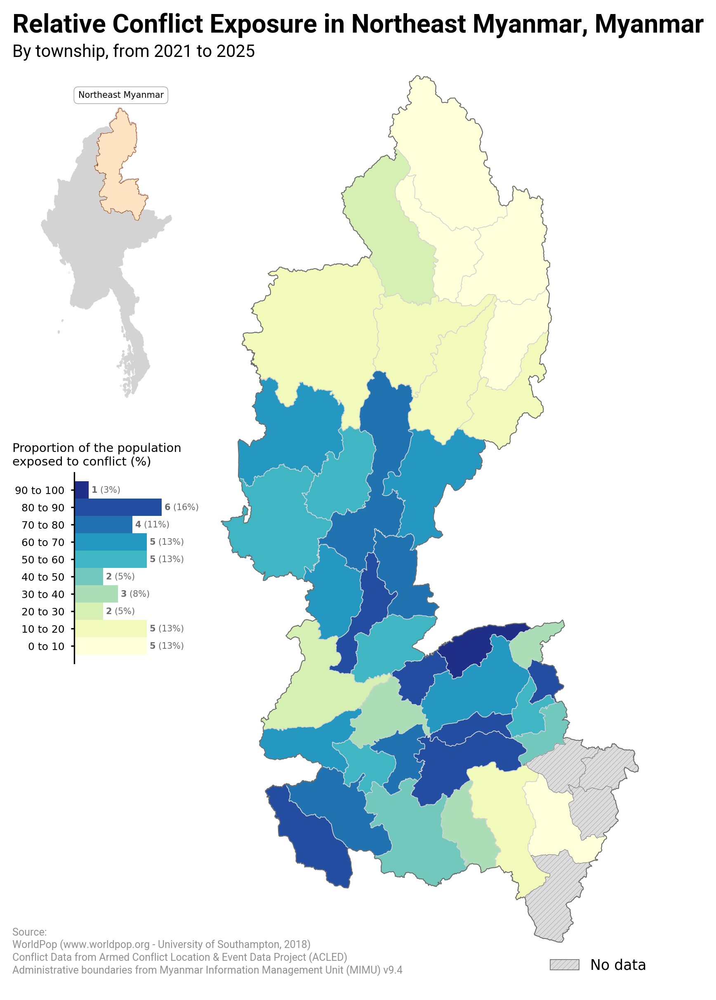

In [57]:
source = "dfcv"
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure",
    zoom_to={"ADM1": "Kayah"},
    subtitle="By township, from 2021 to 2025"
)
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure_relative",
    zoom_to={"BLOC": "Northeast Myanmar"},
    subtitle="By township, from 2021 to 2025",
    var_bounds=[0, 100]
)

## Map Exposure to a Single Hazard

C:\Users\Isabelle\Documents\GFDRR\dfcv\colocation-mapping\utils\map_utils.py:169: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  cbar.ax.set_yticklabels(cbar.ax.get_yticklabels(), fontsize=config["cbar_fontsize"])


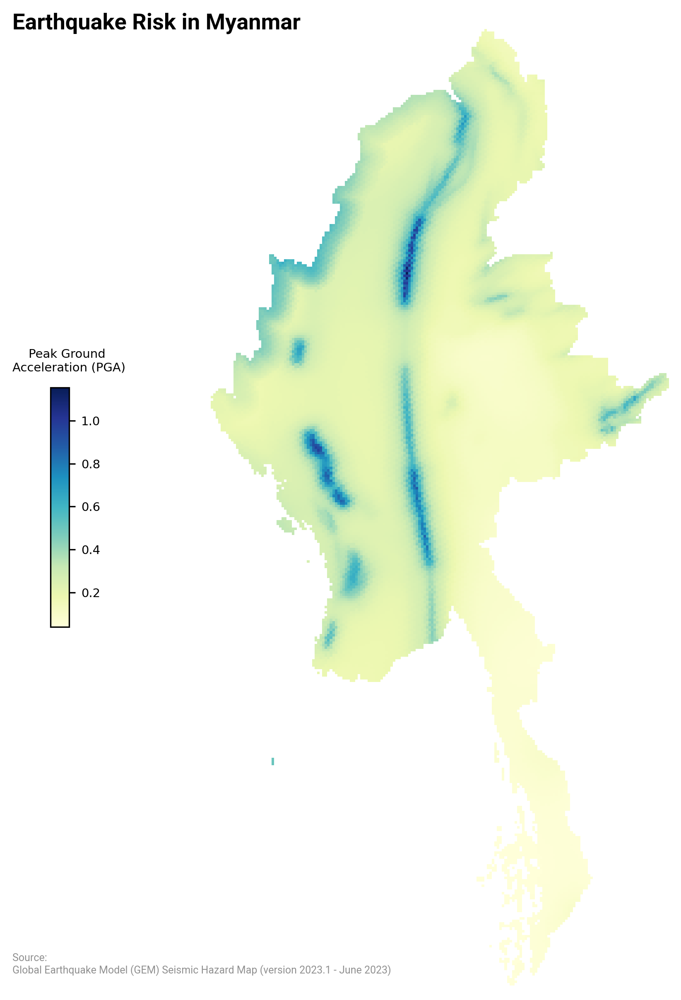

In [22]:
hazard = "earthquake"
geoplot.plot_raster(hazard);

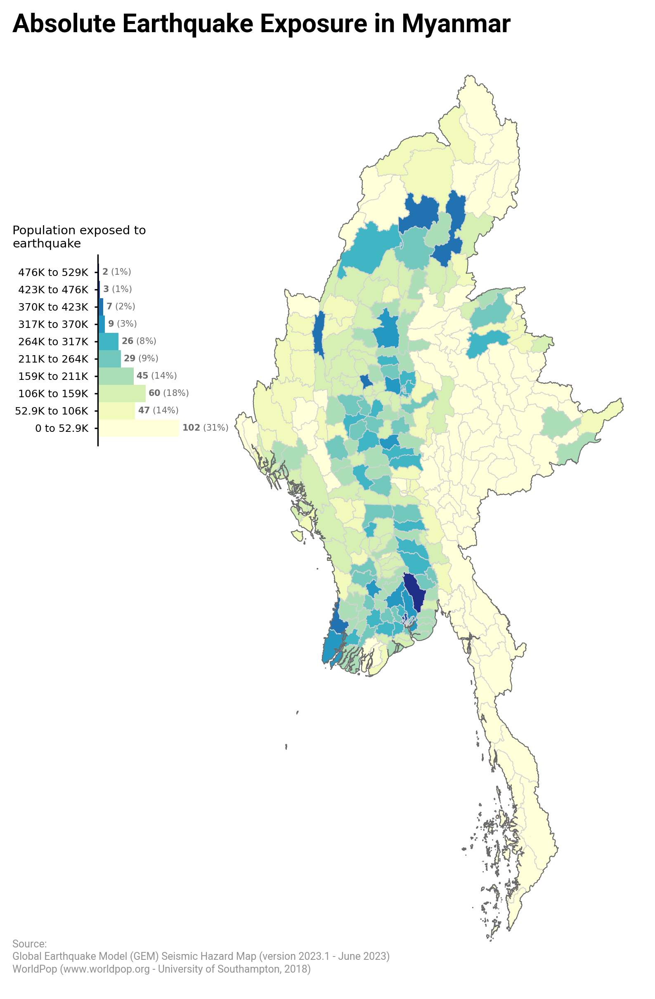

In [23]:
geoplot.plot_choropleth(f"{hazard}_exposure")

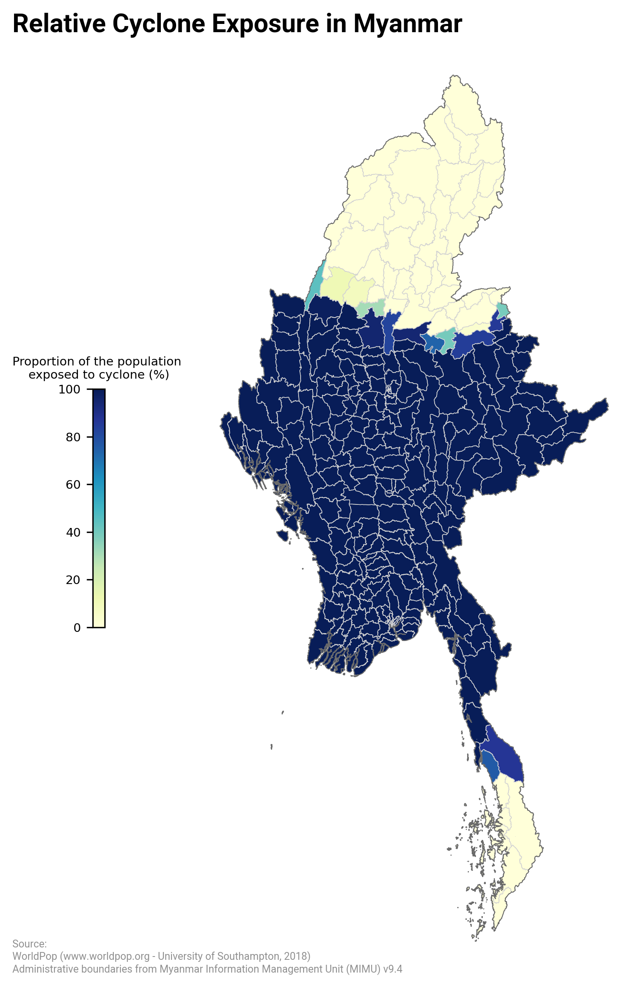

In [87]:
hazard = "cyclone"
geoplot.plot_choropleth(
    f"{hazard}_exposure_relative",
    update_config={
        "legend_type": "colorbar",
    }
)

## Plot Multi-hazard Exposure Index and Multi-hazard Conflict Exposure Index

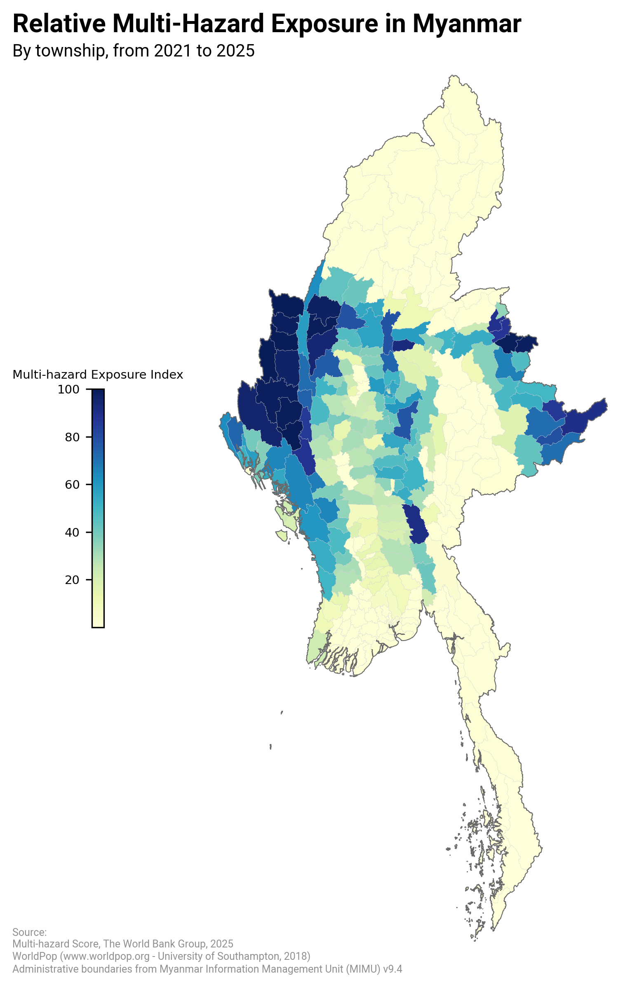

In [88]:
geoplot.plot_choropleth( 
    var="mhs_exposure_relative",
    subtitle="By township, from 2021 to 2025",
    update_config={
        "legend_type": "colorbar", 
        "linewidth": 0.1
    }
)

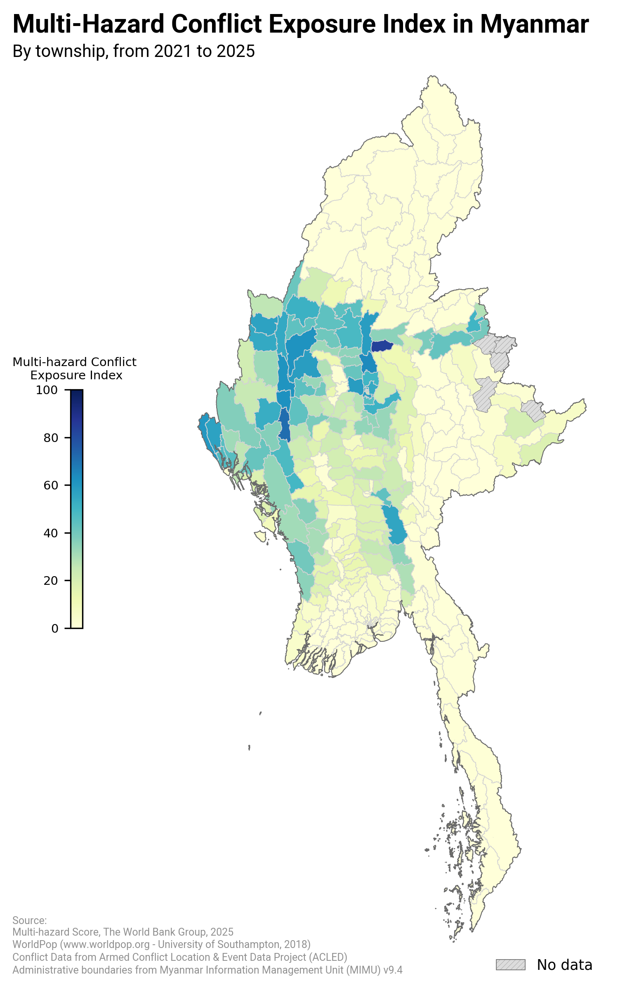

In [102]:
geoplot.plot_choropleth( 
    var="mhs_dfcv_conflict_exposure_relative",
    var_bounds=[0, 100],
    subtitle="By township, from 2021 to 2025",
    update_config={"legend_type": "colorbar"}
)

# Bivariate Choropleth: Overlay Multi-hazard and Conflict Exposure

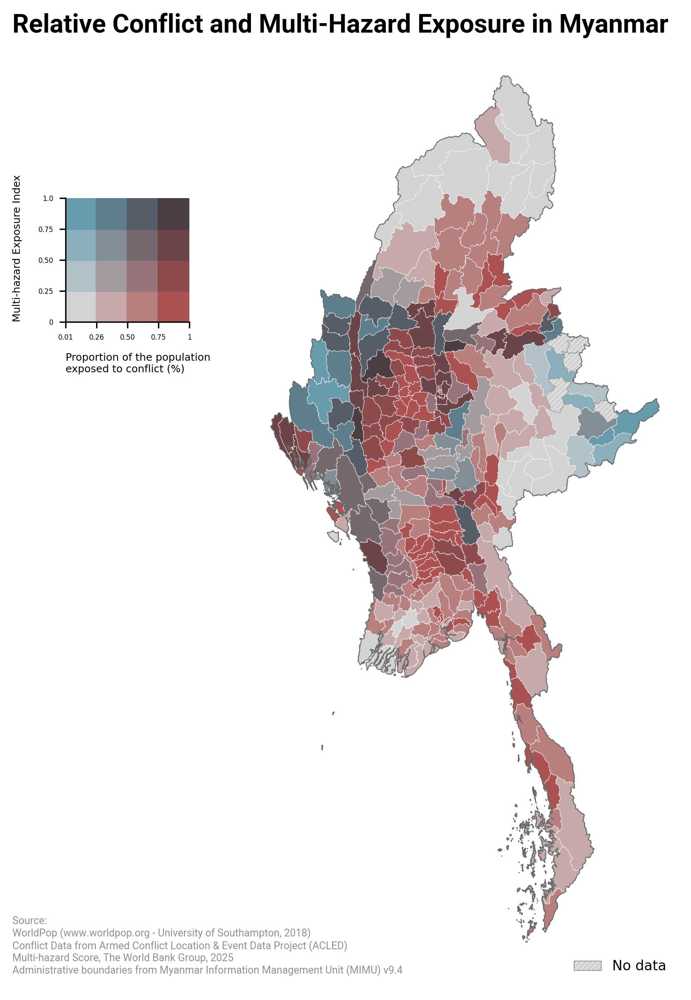

In [105]:
geoplot.plot_bivariate_choropleth( 
    var1="dfcv_conflict_exposure_relative",
    var2="mhs_exposure_relative",
    #var1_bounds=[0, 1],
    #var2_bounds=[0, 1],
    binning="equal_intervals",
    update_config={
        "legend_fontsize": 4, 
        "edgecolor": "white", 
        "linewidth": 0.2
    }
)

## Zoom Bivariate Choropleth to a specific region

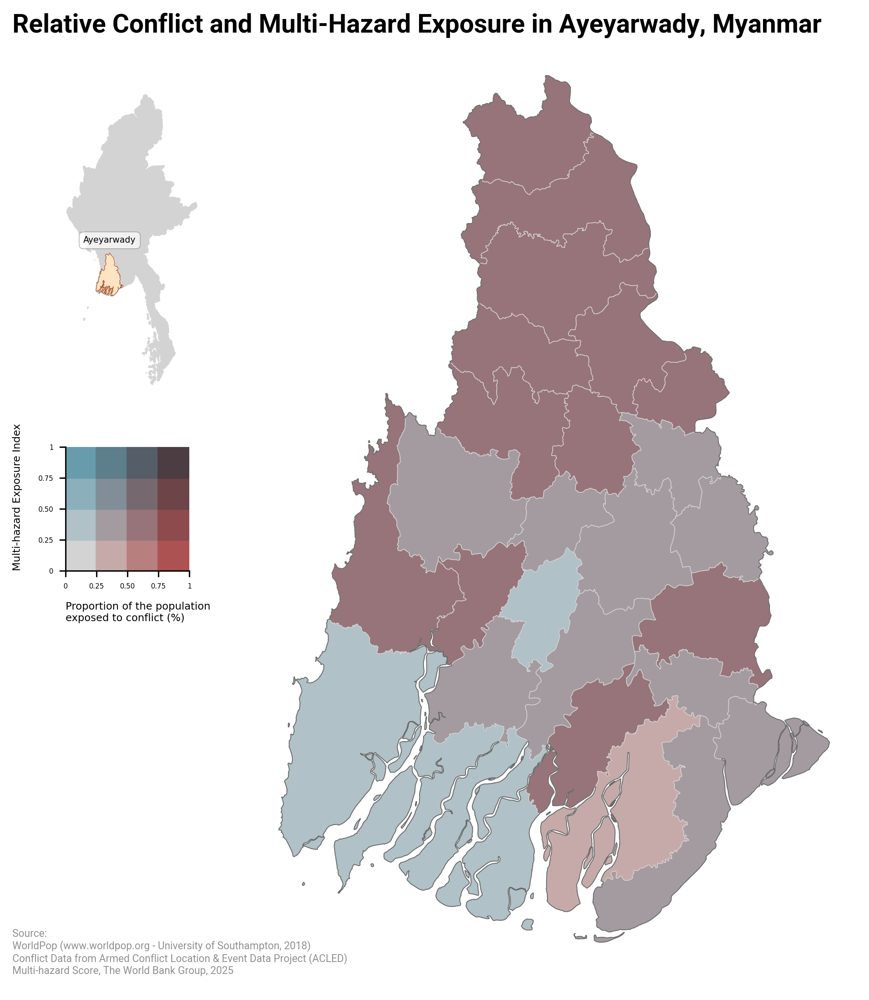

In [294]:
geoplot.plot_bivariate_choropleth( 
    var1="dfcv_conflict_exposure_relative",
    var2="mhs_exposure_relative",
    var1_bounds=[0, 1],
    var2_bounds=[0, 1],
    binning="equal_intervals",
    update_config={"legend_fontsize": 4},
    zoom_to={"ADM1": "Ayeyarwady"},
)

## Interactive Map

In [75]:
geoplot.plot_folium(
    adm_level=adm_level,
    var="mhs_dfcv_conflict_exposure_relative"
)